# Visualización de dataset de ALeRCE

### Imports

In [2]:
import os, sys, time, requests, warnings

from datetime import datetime
from collections import OrderedDict

from IPython.display import HTML, IFrame
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

import numpy as np

import pandas as pd
from pandas.io.json import json_normalize

import matplotlib.pyplot as plt
from matplotlib.collections import PatchCollection
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline
import seaborn as sns

from sklearn.preprocessing import StandardScaler, QuantileTransformer
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer

import astropy.units as u
from astropy.time import Time
from astropy import coordinates

from astroquery.ned import Ned
from astroquery.simbad import Simbad

import umap

import json

from alerce.api import AlerceAPI

import psycopg2

### Cargar datos con etiquetas

In [3]:
'''
Cargando los datos. 
    -df:        Tiene todos los features de las estrellas que estan etiquetadas. 
    -df_labels: Tiene solo las clases de estrella segun ALeRCE
'''

datadir = os.getcwd()
df = pd.read_pickle("%s/all_features.pkl" % datadir)
df_labels = pd.read_csv("%s/dfcrossmatches_prioritized.csv" % datadir)
df_labels.set_index('oid', inplace=True)
df_labels = pd.DataFrame(df_labels['classALeRCE'])
df=df.merge(df_labels, on='oid')
df_labels=pd.DataFrame(df['classALeRCE'])

#Acá saco las clases con menos de 1600 representantes
dict_l = dict([(s,len(np.where(df['classALeRCE']==s)[0])) for s in np.unique(df['classALeRCE'])])
df_labels = df_labels[df['classALeRCE'].map(dict([(s, True) for s in dict_l.keys() if dict_l[s]>=1600]))==True]
df = df[df['classALeRCE'].map(dict([(s, True) for s in dict_l.keys() if dict_l[s]>=1600]))==True]
df=df.drop(columns='classALeRCE')


'''
Limpiando el dataset. Definir "N", "p" y "fill". 
    -N (int): Tamaño de la muestra que se tomará (<= df.shape[0])
    -p (int): Si una columna tiene mas de p% de NaN, es eliminada. 
    -fill (str): Se realizan imputations dependiendo de si se prefiere llenar con 'negativos', 'ceros' o con la 'media' de los datos.
'''

N=200000
p=50
fill='negativos'

'''#Se borran algunos features que no cumplen el porcentaje minimo de NaN
booleans=df.isna().sum()>df.shape[0]*p/100
columnas=[]
for n in range(0,df.shape[1]-1):
    if booleans[n]==True:
        columnas.append(df.columns[n])
#for s in df.columns:
#    if 'Mean' in s or 'mean' in s:
#        columnas.append(s)

df=df.drop(columns=columnas)
'''
#Se toma una muestra aleatoria
chosen_idx = np.random.choice(df.shape[0], replace=False, size=min(N,df.shape[0]))
df_trimmed = df.iloc[chosen_idx]
data_l = df_labels.iloc[chosen_idx]

#Se hacen las imputations
if fill=='ceros':
    data=df_trimmed.fillna(0)
elif fill=='negativos':
    data=df_trimmed.fillna(-99999)
elif fill=='media':
    imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')
    imp_mean.fit(df)
    SimpleImputer()
    i=df_trimmed.index
    c=df_trimmed.columns
    data=pd.DataFrame(imp_mean.transform(df_trimmed), index=i, columns=c)

qt = QuantileTransformer(n_quantiles=10000, random_state=0)
data = pd.DataFrame(qt.fit_transform(data), index=data.index, columns=data.columns)
labels=list(data_l['classALeRCE'])

#Lista con los colores para plotear:    
d = dict([(y,x+1) for x,y in enumerate(sorted(set(labels)))])
colores=[d[x] for x in labels]

data.shape

FileNotFoundError: [Errno 2] No such file or directory: '/home/fbadilla/Practica I/wacolda/all_features.pkl'

### Undersampling

ClusterCentroid

In [76]:
from imblearn.under_sampling import ClusterCentroids
cc = ClusterCentroids(random_state=0)
data_res, lab_res = cc.fit_resample(data, labels)

data = pd.DataFrame(data_res, columns=data.columns)
data_l = pd.DataFrame(lab_res, columns=data_l.columns)
labels = list(lab_res)
d = dict([(y,x+1) for x,y in enumerate(sorted(set(labels)))])
colores=[d[x] for x in labels]

data.shape

(6695, 142)

RandomUnderSampler

In [3]:
from imblearn.under_sampling import RandomUnderSampler
rus = RandomUnderSampler(random_state=0, replacement=True)
data_res, lab_res = rus.fit_resample(data, labels)

data = pd.DataFrame(data_res, columns=data.columns)
data_l = pd.DataFrame(lab_res, columns=data_l.columns)
labels = list(lab_res)
d = dict([(y,x+1) for x,y in enumerate(sorted(set(labels)))])
colores=[d[x] for x in labels]

qt = QuantileTransformer(n_quantiles=500, random_state=0)
data = pd.DataFrame(qt.fit_transform(data), index=data.index, columns=data.columns)

data.shape

(14214, 142)

### Reducción con UMAP

In [4]:
#warnings.filterwarnings('once')
warnings.filterwarnings('ignore')

fit = umap.UMAP(n_neighbors=20, min_dist=0.0, n_components=2, random_state=21, metric='euclidean')
u   = fit.fit_transform(data)
df_umap = pd.DataFrame(dict(comp1=u[:,0], comp2=u[:,1], clase=labels), index=data.index )
df_bokeh = pd.concat([data, df_umap], axis=1)

### Visualización con Bokeh

In [5]:
import bokeh.plotting as bpl
import bokeh.models as bmo
from bokeh.palettes import d3
from bokeh.models import HoverTool, CustomJS
from bokeh.application.handlers import FunctionHandler
from bokeh.application import Application
from bokeh.layouts import column, row, WidgetBox
from bokeh.io import push_notebook

bpl.output_notebook()

Loading BokehJS ...

In [6]:
scatter_figure = bpl.figure(
    active_scroll="wheel_zoom",
    plot_height=600, plot_width=800,
    title='Bokeh para Datos Astronomicos')

palette = d3['Category20'][17]
color_map = bmo.CategoricalColorMapper(factors=df_bokeh['clase'].unique(), palette=palette)

scatter = scatter_figure.circle(
    x='comp1', y='comp2', legend='clase', 
    color={'field': 'clase', 'transform': color_map},
    source=df_bokeh,
    alpha=0.8,
    size=4)

scatter_figure.xgrid.grid_line_color = None
scatter_figure.ygrid.grid_line_color = None

tooltips = [
    ('Clase', '@clase'),
   ]

scatter_figure.legend.location = "bottom_left"
scatter_figure.add_tools(HoverTool(tooltips=tooltips))

bpl.show(scatter_figure)

### Kmapper

In [14]:
import kmapper as km
from sklearn import ensemble, cluster
import sklearn
warnings.filterwarnings('ignore')

X = np.array(data)

projector = ensemble.IsolationForest(random_state=0, n_jobs=-1)
projector.fit(X)
lens1 = projector.decision_function(X)

mapper = km.KeplerMapper(verbose=0)
lens2 = mapper.fit_transform(X, projection="knn_distance_3")

lens = np.c_[lens1, lens2]

G = mapper.map(
    lens,
    X,
    nr_cubes=20,
    overlap_perc=0.1,
    clusterer=cluster.AgglomerativeClustering(2))

_ = mapper.visualize(
    G,
    color_function=np.array(colores),
    path_html="mapper.html",
    title="Implementación de Mapper sobre dataset de ALeRCE",
    custom_tooltips=np.array(labels),
    nbins=len(np.unique(labels))
)

IFrame(src='./mapper.html', width=1000, height=600)

# Clasificación supervizada

### SVM con UMAP

In [3]:
import os
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import fetch_openml
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from matplotlib.collections import PatchCollection
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from scipy.spatial import distance_matrix as distm

plt.rcParams.update({'font.size': 22})

#### Separación de conjuntos Train/Test. Aplicación de UMAP para reducir dimensiones

In [16]:
#warnings.filterwarnings('once')
warnings.filterwarnings('ignore')

X_train, X_test , y_train, y_test= train_test_split(data, labels, test_size = 0.8, random_state = 0)

fit = umap.UMAP(n_neighbors=20, min_dist=0.0, n_components=15, random_state=21, metric='euclidean')
umap_train   = fit.fit_transform(X_train)
umap_test    = fit.transform(X_test)

#### Se definen kernels para comparar (en construcción)

In [6]:
def kernel_log(X,Y, d=0.7):
    """
    Retorna la evaluacion del kernel K(x,y)=-log(||x-y||**d + 1)
    """
    return -np.log(distm(X,Y)**d + 1)

def kernel_hist(data_1, data_2):
    if np.any(data_1 < 0) or np.any(data_2 < 0):
        warnings.warn('Min kernel requires data to be strictly positive!')

    kernel = np.zeros((data_1.shape[0], data_2.shape[0]))

    for d in range(data_1.shape[1]):
        column_1 = data_1[:, d].reshape(-1, 1)
        column_2 = data_2[:, d].reshape(-1, 1)
        kernel += np.minimum(column_1, column_2.T)

    return kernel

### Se aplica SVM

In [19]:
vmat_log = confusion_matrix(y_test, y_pred, normalize='true')

In [17]:
svc = SVC(kernel='rbf', C=4, class_weight='balanced')
svc.fit(umap_train, y_train)
y_pred_train = svc.predict(umap_train)
y_pred = svc.predict(umap_test)

vmat_log = confusion_matrix(y_test, y_pred, normalize='True')
#vmat_logt =classification.confusion_matrix(y_train, y_pred_train)

print('SVM sobre entrenamiento')
print(classification_report(y_train, y_pred_train))
print('=======================================================')
print('SVM sobre test')
print(classification_report(y_test, y_pred))

NameError: name 'classification' is not defined

### Matriz de confusión

In [17]:
from collections import Counter
Counter(y_test)

Counter({'EB/EW': 612,
         'AGN': 574,
         'EA': 581,
         'RRL': 608,
         'QSO': 585,
         'LPV': 594})

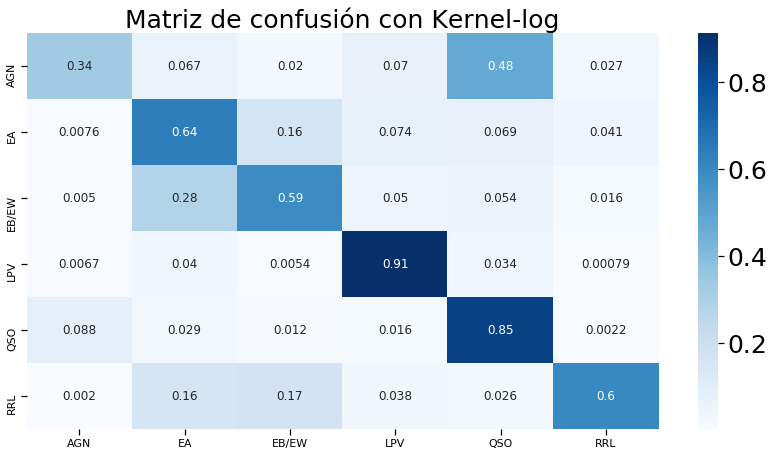

In [22]:
import pandas as pd
import seaborn as sb
sb.set_context('notebook', font_scale=1.0)

df_cm = pd.DataFrame(vmat_log, columns=list(np.unique(labels)), index=list(np.unique(labels)))

fig = plt.figure(figsize=(11.6,6.5))
plt.title('Matriz de confusión con Kernel-log', fontsize=25)
plt.rc('xtick',labelsize=25)
plt.rc('ytick',labelsize=25)
sb.heatmap(df_cm, annot=True, cmap='Blues')
plt.tight_layout()
plt.show()
fig.savefig('Kernel-log.pdf', format='pdf', bbox_inches='tight')

In [51]:
A=np.array([[1,2,3],[3,3,1],[7,2,1]])

In [179]:
def kernel_hist(X, Y):
    K=np.zeros((X.shape[0],X.shape[0]))
    for m in range(X.shape[0]):
        for l in range(m+1):
            K[m][l]=sum(min(X[m][n],Y[m][n]) for n in range(X.shape[1]))
    return K + K.T - np.diag(K.diagonal())

In [182]:
A[0]

array([1, 2, 3])

In [180]:
kernel_hist(umap_train, umap_train)

array([[  9.40392886,   8.13621177,   7.32376851, ...,   8.56047557,
        -13.1075808 ,   8.64879544],
       [  8.13621177,   8.13621177,   7.32376851, ...,   8.56047557,
        -13.1075808 ,   8.64879544],
       [  7.32376851,   7.32376851,   7.32376851, ...,   8.56047557,
        -13.1075808 ,   8.64879544],
       ...,
       [  8.56047557,   8.56047557,   8.56047557, ...,   8.56047557,
        -13.1075808 ,   8.64879544],
       [-13.1075808 , -13.1075808 , -13.1075808 , ..., -13.1075808 ,
        -13.1075808 ,   8.64879544],
       [  8.64879544,   8.64879544,   8.64879544, ...,   8.64879544,
          8.64879544,   8.64879544]])

In [157]:
b + b.T - np.diag(b.diagonal())

array([[6, 6, 6],
       [6, 1, 1],
       [6, 1, 4]])

In [156]:
b=np.array([[6,0,0],[6,1,0],[6,1,4]])

In [160]:
b[0][0]=0

In [87]:
A.shape

(3, 3)

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [ ]:
def kernel_log(X,Y, d=0.7):
    """
    Retorna la evaluacion del kernel K(x,y)=-log(||x-y||**d + 1)
    """
    return -np.log(distm(X,Y)**d + 1)

In [137]:
np.zeros(3)

SyntaxError: invalid syntax (<ipython-input-137-9d2bbbe2b168>, line 1)

In [129]:
K=
sum(min(A[m][n],b[m][n]) for n in range(A[m].shape))

5

In [130]:
distm(A,b)

array([[5.19615242, 5.19615242, 5.19615242],
       [4.69041576, 4.69041576, 4.69041576],
       [3.31662479, 3.31662479, 3.31662479]])

In [138]:
v1=A[0]

In [139]:
v2=b[0]

In [143]:
v1

array([1, 2, 3])

In [142]:
V=np.concatenate(v1,v2)

TypeError: only integer scalar arrays can be converted to a scalar index

In [119]:
sum(min(A[n],b[n]) for n in range(A.shape[0]))

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [103]:
kernel_log(A,b)

array([[-1.4277726 , -1.4277726 , -1.4277726 ],
       [-1.37376016, -1.37376016, -1.37376016],
       [-1.19835543, -1.19835543, -1.19835543]])

In [ ]:
def kernel_hist(X, Y):
    sum(min(x,y) for x in X for y in Y)